In [1]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
df = pd.read_csv("owid-covid-data.csv")
df.info()
df.describe()
df.head()
df.shape
df.value_counts(dropna = False)
df.columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 429435 entries, 0 to 429434
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    429435 non-null  object 
 1   continent                                   402910 non-null  object 
 2   location                                    429435 non-null  object 
 3   date                                        429435 non-null  object 
 4   total_cases                                 411804 non-null  float64
 5   new_cases                                   410159 non-null  float64
 6   new_cases_smoothed                          408929 non-null  float64
 7   total_deaths                                411804 non-null  float64
 8   new_deaths                                  410608 non-null  float64
 9   new_deaths_smoothed                         409378 non-null  float64
 

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [3]:
print(df.isnull().sum())

iso_code                                        0
continent                                   26525
location                                        0
date                                            0
total_cases                                 17631
                                            ...  
population                                      0
excess_mortality_cumulative_absolute       416024
excess_mortality_cumulative                416024
excess_mortality                           416024
excess_mortality_cumulative_per_million    416024
Length: 67, dtype: int64


In [4]:
duplicates = df[df.duplicated()]
duplicates.value_counts()

Series([], Name: count, dtype: int64)

In [5]:
df['date'] = pd.to_datetime(df['date'])
df = df[df['continent'].notnull()]
df = df[df['total_cases'].notnull()]
df = df.dropna(subset=['new_cases_smoothed', 'new_deaths_smoothed'])
df[['new_cases_smoothed', 'new_deaths_smoothed']].isnull().sum()

new_cases_smoothed     0
new_deaths_smoothed    0
dtype: int64

In [6]:
latest_date = df['date'].max()
latest = df[df['date'] == latest_date]

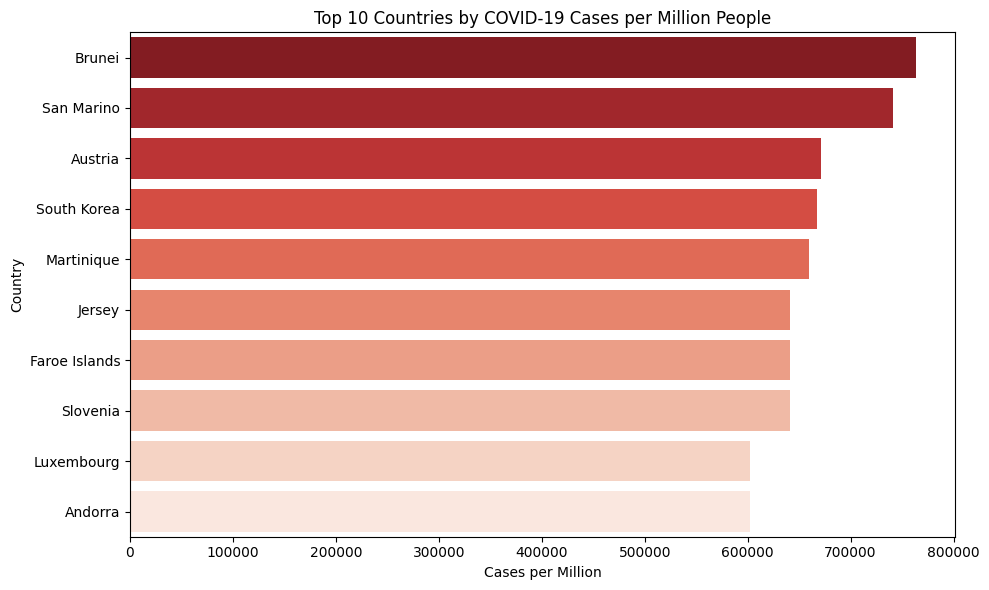

In [8]:
top_countries = latest.sort_values(by='total_cases_per_million', ascending=False).head(10)

num_bars = len(top_countries)
red_palette = sns.color_palette("Reds", n_colors=len(top_countries))[::-1]

plt.figure(figsize=(10, 6))
sns.barplot(
    data=top_countries,
    x='total_cases_per_million',
    y='location',
    hue='location',          
    palette= red_palette,
    legend=False              
)
plt.title("Top 10 Countries by COVID-19 Cases per Million People")
plt.xlabel("Cases per Million")
plt.ylabel("Country")
plt.tight_layout()
plt.show()

/var/folders/gq/_hkfks214y925nq_01dxwdmm0000gn/T/ipykernel_10323/4158820969.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  germany['new_cases_7day_avg'] = germany['new_cases'].rolling(7).mean()


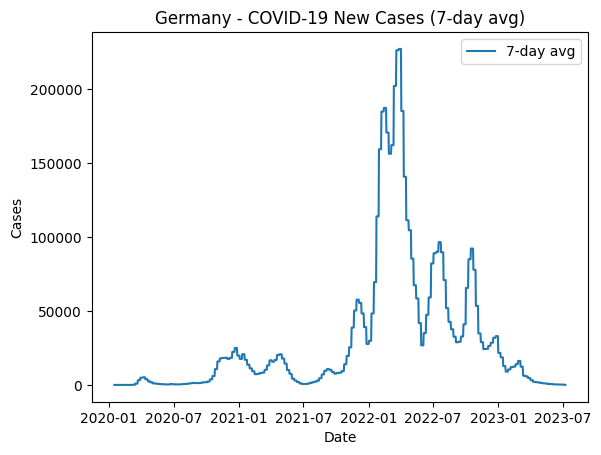

In [15]:
germany = df[df['location'] == 'Germany']
germany['new_cases_7day_avg'] = germany['new_cases'].rolling(7).mean()

plt.plot(germany['date'], germany['new_cases_7day_avg'], label='7-day avg')
plt.title("Germany - COVID-19 New Cases (7-day avg)")
plt.xlabel("Date")
plt.ylabel("Cases")
plt.legend()
plt.show()

In [16]:
fig = px.choropleth(
    df,
    locations="location",
    locationmode="country names",
    color="total_cases",
    hover_name="location",
    color_continuous_scale="Reds",
    title=f"Total COVID-19 Cases by Country ({latest_date.date()})"
)
fig.show()

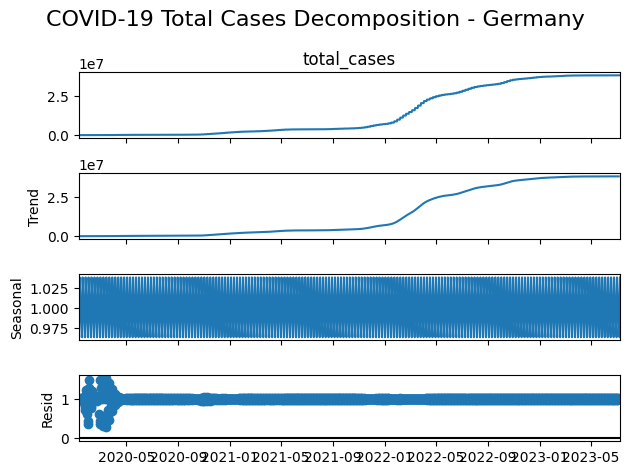

In [17]:
country_df = df[df['location'] == 'Germany'].copy()
country_df['date'] = pd.to_datetime(country_df['date'])
country_df = country_df.sort_values('date')
country_df.set_index('date', inplace=True)
country_df['total_cases'] = country_df['total_cases'].interpolate()
result = seasonal_decompose(country_df['total_cases'], model='multiplicative', period=7)

result.plot()
plt.suptitle('COVID-19 Total Cases Decomposition - Germany', fontsize=16)
plt.tight_layout()
plt.show()

In [18]:
df.to_csv("owid-covid-data-cleaned.csv", index=False)